### Train best model according to report to try to reproduce results

- All static features: 
    * Z500, 
    * T850, 
    * latitude, 
    * orography, 
    * land-sea mask, 
    * soil type, and 
    * top-of-atmosphere radiation
- L=2
- $\Delta t$ = 6

#### Import libraries

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random

import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader

from modules.utils import train_model_2steps_temp, init_device
from modules.data import WeatherBenchDatasetXarrayHealpixTemp
from modules.healpix_models import UNetSphericalHealpix, UNetSphericalTempHealpix, _compute_laplacian_healpix, ConvBlock
from modules.test import create_iterative_predictions_healpix_temp, compute_rmse_healpix
from modules.layers import (ConvCheb, PoolMaxHealpix, UnpoolMaxHealpix,
                            ConvChebTemp, PoolMaxTempHealpix, UnpoolMaxTempHealpix)
from modules.plotting import plot_rmses

datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
figures_path = datadir + 'figures/' + description + '/'

description = "masked_loss"

model_filename = model_save_path + "spherical_unet_" + description + ".h5"
pred_filename = pred_save_path + "spherical_unet_" + description + ".nc"
rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'

if not os.path.isdir(model_save_path):
    os.mkdir(model_save_path)
    
if not os.path.isdir(pred_save_path):
    os.mkdir(pred_save_path)

if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [3]:
import warnings
warnings.filterwarnings("ignore")

Define constants and load data

In [4]:
chunk_size = 521#483*2 #483

In [5]:
train_years = ('1979', '2012')#('1979', '2012')
val_years = ('2013', '2016')
test_years = ('2017', '2018')

nodes = 12*16*16
max_lead_time = 5*24
nb_timesteps = 2

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"
gpu = [0]
num_workers = 10
pin_memory = True

nb_epochs = 20
learning_rate = 8e-3

obs = xr.open_mfdataset(pred_save_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
rmses_weyn = xr.open_dataset(datadir + 'metrics/rmses_weyn.nc')

#### Define functions

In [6]:
from modules.data import WeatherBenchDatasetIterative
class WeatherBenchDatasetXarrayHealpixTemp(Dataset):
    
    """ Dataset used for graph models (1D), where data is loaded from stored numpy arrays.
    
    Parameters
    ----------
    ds : xarray Dataset
        Dataset containing the input data
    out_features : int
        Number of output features
    delta_t : int
        Temporal spacing between samples in temporal sequence (in hours)
    len_sqce : int
        Length of the input and output (predicted) sequences
    years : tuple(str)
        Years used to split the data
    nodes : float
        Number of nodes each sample has
    max_lead_time : int
        Maximum lead time (in case of iterative predictions) in hours
    load : bool
        If true, load dataset to RAM
    mean : np.ndarray of shape 2
        Mean to use for data normalization. If None, mean is computed from data
    std : np.ndarray of shape 2
        std to use for data normalization. If None, mean is computed from data
    """
        
    def __init__(self, ds, out_features, delta_t, len_sqce, years, nodes, nb_timesteps, 
                 max_lead_time=None, load=True, mean=None, std=None):
        
        
        self.delta_t = delta_t
        self.len_sqce = len_sqce
        self.years = years
        
        self.nodes = nodes
        self.out_features = out_features
        self.max_lead_time = max_lead_time
        self.nb_timesteps = nb_timesteps
        
        self.data = ds.to_array(dim='level', name='Dataset').transpose('time', 'node', 'level')
        self.in_features = self.data.shape[-1]
        
        self.mean = self.data.mean(('time', 'node')).compute() if mean is None else mean
        self.std = self.data.std(('time', 'node')).compute() if std is None else std
        
        eps = 0.001 #add to std to avoid division by 0
        
        # Count total number of samples
        total_samples = self.data.shape[0]        
        
        if max_lead_time is None:
            self.n_samples = total_samples - (len_sqce+1) * delta_t
        else:
            self.n_samples = total_samples - (len_sqce+1) * delta_t - max_lead_time
        
        # Normalize
        self.data = (self.data - self.mean.to_array(dim='level')) / (self.std.to_array(dim='level') + eps)
        self.data.persist()
        
        self.idxs = np.array(range(self.n_samples))
        
        print('Loading data to RAM...')
        t = time.time()
        self.data.load()
        print('Time: {:.2f}s'.format(time.time() - t))
        
        
    def __len__(self):
        return self.n_samples
    
    def __getitem__(self, idx):
        """ Returns sample and label corresponding to an index as torch.Tensor objects
            The return tensor shapes are (for the sample and the label): [n_vertex, len_sqce, n_features]
            
        """
        idx_data = idx#self.idxs[idx]
        #1,0,2
        
        #batch[0] --> (batch_size, num_nodes, n_features*len_sq)
        idx_full = np.concatenate(np.array([[idx_data+self.delta_t*k] for k in range(self.len_sqce+2)]).reshape(-1,1)) # ex: len_sqce=2 --> we need 0,1,2,3
        #idx_full = np.concatenate([idx_data+delta_t,  idx_data + delta_t * len_sqce, idx_data + delta_t * (len_sqce+1)])
        dat = self.data.isel(time=idx_full).values
        
        
        X = (
            torch.tensor(dat[:len(idx)*self.len_sqce,:,:] , \
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1),
        )
        
        y = (torch.tensor(dat[len(idx):len(idx)*(self.len_sqce+1),:,:],\
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1),\
             torch.tensor(dat[len(idx)*(self.len_sqce):,:,:out_features],\
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1)
        
        )
        return X, y 

#### Load data

In [7]:
z500 = xr.open_mfdataset(f'{input_dir}geopotential_500/*.nc', combine='by_coords', chunks={'time':chunk_size}).rename({'z':'z500'})
t850 = xr.open_mfdataset(f'{input_dir}temperature_850/*.nc', combine='by_coords', chunks={'time':chunk_size}).rename({'t':'t850'})
rad = xr.open_mfdataset(f'{input_dir}toa_incident_solar_radiation/*.nc', combine='by_coords', chunks={'time':chunk_size})

z500 = z500.isel(time=slice(7, None))
t850 = t850.isel(time=slice(7, None))

constants = xr.open_dataset(f'{input_dir}constants/constants_5.625deg_standardized.nc')

orog = constants['orog']
lsm = constants['lsm']
lats = constants['lat2d']
slt = constants['slt']
cos_lon = constants['cos_lon']
sin_lon = constants['sin_lon']

num_constants = len([orog, lats, lsm, slt])

In [8]:
# z500, t850, orog, lats, lsm, slt, rad
#feature_idx = [0, 1]
ds = xr.merge([z500, t850, rad], compat='override')
#ds = xr.merge([z500, t850, orog, lats, lsm, slt, rad], compat='override')

ds_train = ds.sel(time=slice(*train_years))
ds_valid = ds.sel(time=slice(*val_years))
ds_test = ds.sel(time=slice(*test_years))


In [9]:
train_mean_ = xr.open_mfdataset(f'{input_dir}mean_train_features_dynamic.nc')
train_std_ = xr.open_mfdataset(f'{input_dir}std_train_features_dynamic.nc')

#### Define model parameters

In [10]:
# define length of sequence to take into account for loss
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

batch_size = 50

In [11]:
#description = "no_const"


In [12]:
# Train and validation data
training_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_train, out_features=out_features, delta_t=delta_t,
                                                   len_sqce=len_sqce, max_lead_time=max_lead_time,
                                                   years=train_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                   mean=train_mean_, std=train_std_, load=False)
validation_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_valid, out_features=out_features, delta_t=delta_t,
                                                     len_sqce=len_sqce, max_lead_time=max_lead_time,
                                                     years=val_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                     mean=train_mean_, std=train_std_, load=False)


Loading data to RAM...
Time: 39.34s
Loading data to RAM...
Time: 4.38s


In [13]:
mask = np.zeros(3072)
mask[np.where(ds_train.lat.values > 10)[0]] = 1
mask[np.where(ds_train.lat.values < -10)[0]] = 1

In [14]:
mask_t = torch.tensor([mask]*2).repeat(50, 1, 1).transpose(2,1)

In [15]:
#mask_t = mask_t.repeat(1,, 2)

In [16]:
mask_t = mask_t.transpose(2,1)

Define model

In [17]:
def train_model_2steps(model, device, training_ds, constants, batch_size, epochs, lr, validation_ds, mask):    
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, eps=1e-7, weight_decay=0, amsgrad=False)
    
    train_losses = []
    val_losses = []
    n_samples = training_ds.n_samples
    n_samples_val = validation_ds.n_samples
    num_nodes = training_ds.nodes
    num_constants = constants.shape[1]
    out_features = training_ds.out_features
    
    constants_expanded = constants.expand(batch_size, num_nodes, num_constants)
    constants1 = constants_expanded.to(device)
    idxs_val = validation_ds.idxs
    mask_t = torch.tensor([mask]*out_features).repeat(batch_size, 1, 1).transpose(2,1)
    mask_t = mask_t.to(device)
    
    for epoch in range(epochs):
        
        print('\rEpoch : {}'.format(epoch), end="")
        
        time1 = time.time()
        
        val_loss = 0
        train_loss = 0
        
        model.train()  
        
        random.shuffle(training_ds.idxs)
        idxs = training_ds.idxs
        
        batch_idx = 0
        
        for i in range(0, n_samples - batch_size, batch_size):
            
            i_next = min(i + batch_size, n_samples)
            
            if len(idxs[i:i_next]) < batch_size:
                constants_expanded = contants.expand(len(idxs[i:i_next]), num_nodes, num_constants)
                constants1 = constants_expanded.to(device)
            
            
            
            #t1 = time.time()
            batch, labels = training_ds[idxs[i:i_next]]
            
            #t2 = time.time()
            
            # Transfer to GPU
            batch_size = batch[0].shape[0]//2
            
            batch1 = torch.cat((batch[0][:batch_size, :,:], \
                                constants_expanded,batch[0][batch_size:, :,:] ,constants_expanded), dim=2).to(device)
            #batch1 = torch.cat((batch[0], constants_expanded), dim=2).to(device)
            
            label1 = labels[0].to(device)
            label2 = labels[1].to(device)
            
            #t3 = time.time()
            batch_size = batch1.shape[0]
            
            # Model
            
            #t4 = time.time()
            output1 = model(batch1)  
            #t5 = time.time()
            # [z_tdelta1, t_tdelta1, toa_tdelta1, constants, z_tdelta2, t_tdelta2, toa_tdelta2, constants]
            toa_delta = batch[0][batch_size:, :,-1].view(-1, num_nodes, 1).to(device)
            batch2 = torch.cat((output1, toa_delta, constants1, \
                               label1[batch_size:, :,:], constants1), dim=2)
            
            #batch2 = torch.cat((output1, label1[:,:,-1].view(-1, num_nodes, 1), constants1), dim=2)
            #t6 = time.time()
            output2 = model(batch2)
            #t7 = time.time()
            loss = criterion(mask_t*output1, mask_t*label1[batch_size:,:,:out_features]) \
            + criterion(mask_t*output2, mask_t*label2[batch_size:,:,:out_features])
            #t8 = time.time()
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_loss = train_loss + loss.item() * batch_size
            
            
            #print('\nTime to read batch: {}s'.format(t2-t1))
            #print('Time to transfer data to GPU: {}s'.format(t3-t2))
            #print('Time to process input 1: {}s'.format(t5-t4))
            #print('Time to process input 2: {}s'.format(t7-t6))
            #print('Time to compute loss: {}s'.format(t8-t7))
            #print('\n')
            if batch_idx%50 == 0:
                print('\rBatch idx: {}; Loss: {:.3f}'.format(batch_idx, train_loss/(batch_size*(batch_idx+1))), end="")
            batch_idx += 1
        
        train_loss = train_loss / n_samples
        train_losses.append(train_loss)
        
        model.eval()
        
        constants1 = constants_expanded.to(device)
        with torch.set_grad_enabled(False):
            index = 0
            
            for i in range(0, n_samples_val - batch_size, batch_size):
                i_next = min(i + batch_size, n_samples_val)

                if len(idxs_val[i:i_next]) < batch_size:
                    constants_expanded = contants.expand(len(idxs_val[i:i_next]), num_nodes, num_constants)
                    constants1 = constants_expanded.to(device)


                #t1 = time.time()
                batch, labels = validation_ds[idxs_val[i:i_next]]
                # Transfer to GPU
                batch_size = batch[0].shape[0]//2
            
                batch1 = torch.cat((batch[0][:batch_size, :,:], \
                                    constants_expanded,batch[0][batch_size:, :,:] ,constants_expanded), dim=2).to(device)
                label1 = labels[0].to(device)
                label2 = labels[1].to(device)

                batch_size = batch1.shape[0]

                output1 = model(batch1)  
                toa_delta = batch[0][batch_size:, :,-1].view(-1, num_nodes, 1).to(device)
                batch2 = torch.cat((output1, toa_delta, constants1, \
                                   label1[batch_size:, :,:], constants1), dim=2)
                output2 = model(batch2)
                
                val_loss = val_loss + (criterion(output1, label1[batch_size:,:,:out_features]).item() 
                                       + criterion(output2, label2[batch_size:,:,:out_features]).item()) * batch_size
                index = index + batch_size
                
        val_loss = val_loss / n_samples_val
        val_losses.append(val_loss)
        
        time2 = time.time()
        
        # Print stuff
        print('Epoch: {e:3d}/{n_e:3d}  - loss: {l:.3f}  - val_loss: {v_l:.5f}  - time: {t:2f}'
              .format(e=epoch+1, n_e=epochs, l=train_loss, v_l=val_loss, t=time2-time1))
        
    return train_losses, val_losses

In [18]:
class UNetSphericalHealpix(torch.nn.Module):
    """Spherical GCNN UNet
    
     Parameters
    ----------
    N : int
        Number of nodes in the input graph
    in_channels : int
        Number of channels in the input graph.
    out_channels : int
        Number of channels in the output graph.
    kernel_size : int
        Chebychev polynomial degree
    """

    def __init__(self, N, in_channels, out_channels, kernel_size):        
        super().__init__()

        self.kernel_size = kernel_size
       
        laplacians = []
        for i, nodes in enumerate([3072, 768, 192]):
            laplacian = _compute_laplacian_healpix(nodes)
            laplacians.append(laplacian)
        
        
        # Pooling - unpooling
        self.pooling = PoolMaxHealpix(kernel_size=4)
        self.unpool = UnpoolMaxHealpix(kernel_size=4)
        
        # Encoding block 1
        self.conv11 = ConvBlock(in_channels, max(in_channels, 16), kernel_size, laplacians[0])
        self.conv12 = ConvBlock(max(in_channels, 16), max(in_channels, 32), kernel_size, laplacians[0])
        self.conv13 = ConvBlock(max(in_channels, 32), 64, kernel_size, laplacians[0])
        
        # Encoding block 2
        self.conv21 = ConvBlock(64, 88, kernel_size, laplacians[1])
        self.conv22 = ConvBlock(88, 110, kernel_size, laplacians[1])
        self.conv23 = ConvBlock(110, 128, kernel_size, laplacians[1])
       
        # Encoding block 3
        self.conv31 = ConvBlock(128, 256, kernel_size, laplacians[2])
        self.conv32 = ConvBlock(256, 256, kernel_size, laplacians[2])
        self.conv33 = ConvBlock(256, 128, kernel_size, laplacians[2])
        
        # Decoding block 4
        self.uconv21 = ConvBlock(256, 128, kernel_size, laplacians[1])
        self.uconv22 = ConvBlock(128, 64, kernel_size, laplacians[1])
        
        # Decoding block 4
        self.uconv11 = ConvBlock(128, 64, kernel_size, laplacians[0])
        self.uconv12 = ConvBlock(64, 32, kernel_size, laplacians[0])
        self.uconv13 = ConvCheb(32, out_channels, kernel_size, laplacians[0])
        
         
    def encode(self, x):
        """ Encodes an input into a lower dimensional space applying convolutional, batch normalisation and pooling layers
        Parameters
        ----------
        x : torch.Tensor of shape batch_size x n_vertices x in_channels
            Input data
        Returns
        -------
       x_enc3, x_enc2, x_enc1, idx2, idx1 : torch.Tensors of shapes batch_size x n_vertices x layer_channels + list(int)
            Encoded data at the different encoding stages and the indices indicating the locations of the maxium values in
            unpooled images.
        """
        #x_enc1 = self.dropout1(x_enc1)
        
        # Block 1
        
        x_enc1 = self.conv11(x)
        x_enc1 = self.conv12(x_enc1)
        x_enc1 = self.conv13(x_enc1)
        
        # Block 2
        x_enc2, idx1 = self.pooling(x_enc1)
        x_enc2 = self.conv21(x_enc2)
        x_enc2 = self.conv22(x_enc2)
        x_enc2 = self.conv23(x_enc2)
        
        # Block 3
        x_enc3, idx2 = self.pooling(x_enc2)
        x_enc3 = self.conv31(x_enc3)
        x_enc3 = self.conv32(x_enc3)
        x_enc3 = self.conv33(x_enc3)
        
        return x_enc3, x_enc2, x_enc1, idx2, idx1
    
    def decode(self, x_enc3, x_enc2, x_enc1, idx2, idx1):
        """ Decodes low dimensional data into high dimensional applying convolutional, batch normalisation, 
        unpooling layers and skip connections
        
        Parameters
        ----------
        x_enc3, x_enc2, x_enc1, idx2, idx1 : torch.Tensors of shapes batch_size x n_vertices x layer_channels + list(int)
            Encoded data at the different encoding stages and the indices indicating the locations of the maxium values in
            unpooled images.
        Returns
        -------
        x : torch.Tensor of shape batch_size x n_vertices x out_channels
            Decoded data
        """

        # Block 2
        x = self.unpool(x_enc3, idx2)
        x = torch.cat((x, x_enc2), dim=2)
        x = self.uconv21(x)
        x = self.uconv22(x)
        
        # Block 1
        x = self.unpool(x, idx1)
        x = torch.cat((x, x_enc1), dim=2)
        x = self.uconv11(x)
        x = self.uconv12(x)
        x = self.uconv13(x)
            
        return x
    
    def state_dict(self, *args, **kwargs):
        """
        This function overrides the state dict in order to be able to save the model.
        This can be removed as soon as saving sparse matrices has been added to Pytorch.
        """
        state_dict = super().state_dict(*args, **kwargs)
        del_keys = []
        for key in state_dict:
            if "laplacian" in key:
                del_keys.append(key)
        for key in del_keys:
            del state_dict[key]
        return state_dict

    def forward(self, x):
        """Forward Pass
        Parameters
        ----------
        x : torch.Tensor of shape batch_size x n_vertices x in_channels
            Input data
        Returns
        -------
        x : torch.Tensor of shape batch_size x n_vertices x out_channels
            Model output
        """
        x_encoded = self.encode(x)
        output = self.decode(*x_encoded)
        return output

In [19]:
# Model
#spherical_unet = UNetSphericalTempHealpix(N=nodes, len_sqce=len_sqce, in_channels=in_features, out_channels=out_features, graph_width=3)

spherical_unet = UNetSphericalHealpix(N=nodes, in_channels=in_features*len_sqce, out_channels=out_features, kernel_size=3)
spherical_unet, device = init_device(spherical_unet, gpu=gpu)


Train and test. Plot results

In [20]:
epochs=7
lr = 8e-3

In [21]:
constants_tensor = torch.tensor(xr.merge([orog, lats, lsm, slt], compat='override').to_array().values, \
                            dtype=torch.float)



In [22]:
constants_tensor = (constants_tensor - torch.mean(constants_tensor, dim=1).view(-1,1).expand(4, 3072)) / torch.std(constants_tensor, dim=1).view(-1,1).expand(4, 3072)

In [23]:
# Train model
train_loss, val_loss = train_model_2steps(spherical_unet, device, training_ds, constants_tensor.transpose(1,0), \
                                          batch_size=50, epochs=7, \
                                           lr=learning_rate, validation_ds=validation_ds, mask=mask)


Batch idx: 5950; Loss: 0.063Epoch:   1/  7  - loss: 0.063  - val_loss: 0.09094  - time: 3259.274170
Batch idx: 5950; Loss: 0.037Epoch:   2/  7  - loss: 0.037  - val_loss: 0.04685  - time: 3258.324551
Batch idx: 5950; Loss: 0.032Epoch:   3/  7  - loss: 0.032  - val_loss: 0.05191  - time: 3246.275270
Batch idx: 5950; Loss: 0.031Epoch:   4/  7  - loss: 0.031  - val_loss: 0.04090  - time: 3240.388895
Batch idx: 5950; Loss: 0.030Epoch:   5/  7  - loss: 0.030  - val_loss: 0.05090  - time: 3244.156246
Batch idx: 5950; Loss: 0.030Epoch:   6/  7  - loss: 0.030  - val_loss: 0.03809  - time: 3242.706833
Batch idx: 5950; Loss: 0.029Epoch:   7/  7  - loss: 0.029  - val_loss: 0.03917  - time: 3238.130326


In [24]:
model_filename

'../data/healpix/models/spherical_unet_masked_loss.h5'

In [26]:
#torch.save(spherical_unet.state_dict(), model_filename)

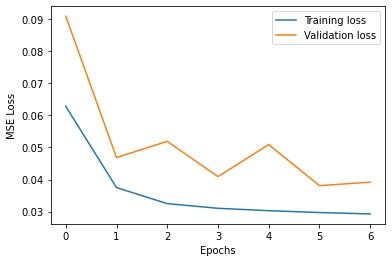

In [27]:
# Show training losses
plt.plot(train_loss, label='Training loss')
plt.plot(val_loss, label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.legend()
plt.show()

del training_ds, validation_ds
torch.cuda.empty_cache()

In [28]:
torch.cuda.empty_cache()

In [29]:
# Testing data
testing_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_test, out_features=out_features,
                                                  len_sqce=len_sqce, delta_t=delta_t, years=test_years, 
                                                  nodes=nodes, nb_timesteps=nb_timesteps, 
                                                  mean=train_mean_, std=train_std_, 
                                                  max_lead_time=max_lead_time)



Loading data to RAM...
Time: 2.60s


Generate predictions using the trained model

In [30]:
def create_iterative_predictions_healpix_temp(model, device, dg, constants):
    
    out_feat = dg.out_features
    
    train_std =  dg.std[['z500','t850']].to_array().values #dg.std.values[:out_feat]
    train_mean = dg.mean[['z500','t850']].to_array().values #dg.mean.values[:out_feat]
    
    delta_t = dg.delta_t
    len_sqce = dg.len_sqce
    max_lead_time = dg.max_lead_time
    initial_lead_time = delta_t * len_sqce
    nodes = dg.nodes
    nside = int(np.sqrt(nodes/12))
    n_samples = dg.n_samples
    in_feat = 2#dg.in_features
    total_feat = 7
    num_constants = constants.shape[1]
    
    
    batch_size = 10
    # Lead times
    lead_times = np.arange(delta_t, max_lead_time + delta_t, delta_t)
    
    # Lat lon coordinates
    out_lon, out_lat = hp.pix2ang(nside, np.arange(nodes), lonlat=True)
    
    # Actual times
    start = np.datetime64(dg.years[0], 'h') + np.timedelta64(initial_lead_time, 'h')
    stop = start + np.timedelta64(dg.n_samples, 'h')
    times = np.arange(start, stop)
    
    # Variables
    var_dict_out = {var: None for var in ['z', 't']}
    
    # Constants
    constants_expanded = constants.expand(batch_size, nodes, num_constants)
    constants1 = constants_expanded.to(device)
    idxs = dg.idxs
    
    
    dataloader = dg
    predictions = []
    model.eval()
    next_batch_ = []
    for num_lead, lead in enumerate(lead_times):
        
        print('\rProcessing lead time {} out of {}'.format(num_lead+1, len(lead_times)), end="")
        outputs = []
        
        batch_idx = 0
        batch_size = 10
        
        time1 = time.time()
        
        for i in range(0, len(idxs) - max_lead_time - len_sqce, batch_size):
            #i_next = min(i + batch_size, n_samples)
            idx_pred = i
            i_next = i+batch_size
            i += num_lead*delta_t
            i_next += num_lead*delta_t
            #print('\r Indices to consult: {} to {}'.format(i, i_next), end="")

            
            if len(idxs[i:i_next]) < batch_size:
                #print('here')
                constants_expanded = constants.expand(len(idxs[i:i_next]), nodes, num_constants)
                constants1 = constants_expanded.to(device)
            
            
            batch, _ = dg[idxs[i:i_next]]
            
                # Transfer to GPU
            batch_size = batch[0].shape[0]//2
                                
            if num_lead == 0:
                inputs = torch.cat((batch[0][:batch_size, :,:], \
                                    constants_expanded,batch[0][batch_size:, :,:] ,constants_expanded), dim=2).to(device)
                next_batch_.append(inputs.detach().cpu().clone())
                
            else:
                #print(i, i_next)
            #elif num_lead >= 1:
                #print(next_batch_[batch_idx][:, :, total_feat:].shape)
                #print(torch.tensor(preds[batch_idx]).shape)
                #print(batch[0][batch_size:, :,-1].view(-1, nodes, 1).shape)
                #print(constants1.shape)
                inputs = torch.cat((
                    next_batch_[batch_idx][:, :, total_feat:].to(device),\
                    torch.tensor(old_outputs[batch_idx]).to(device),\
                    batch[0][batch_size:, :,-1].view(-1, nodes, 1).to(device), \
                                    constants1), dim=2).to(device)
                
                next_batch_[batch_idx] = inputs.detach().cpu().clone() #store z, t, toa
            """
            
            
            
            else:
                #print(inputs.shape)
                #print(preds[i:i_next,:,:].shape)
                return next_batch_[batch_idx], batch[0]
                inputs = torch.cat((
                    next_batch_[batch_idx][:, :, total_feat:].to(device), \
                    
                ))
                inputs = torch.cat((next_batch_[batch_idx][batch_size:, :, ], constants1, \
                                    torch.tensor(preds[i:i_next,:,:]).to(device), \
                                    batch[0][batch_size:, :,-1].view(-1, nodes, 1).to(device), \
                                    constants1), dim=2).to(device)
                next_batch_.append(inputs.detach().cpu().clone())
                #inputs = torch.cat((next_batch_[i:i_next], constants1, \
                #                    torch.tensor(preds[i:i_next,:,:]).to(device), \
                #                    batch[0][batch_size:, :,-1].view(-1, nodes, 1).to(device), \
                #                    constants1), dim=2).to(device)
                
            """
                
            output = model(inputs)
            
            #next_batch_.append(inputs[:, :, in_feat:].detach().cpu().clone().numpy())
            outputs.append(output.detach().cpu().clone().numpy()[:, :, :out_feat])
            batch_idx += 1
        
        
        old_outputs = outputs.copy()
        preds = np.concatenate(outputs)
        
        predictions.append(np.concatenate(outputs) * train_std + train_mean)

        """
        for i, (sample, _) in enumerate(dataloader):
            inputs = sample[0].to(device)
            output = model(inputs)
            
            next_batch_.append(inputs[:, :, in_feat:].detach().cpu().clone().numpy())
            outputs.append(output.detach().cpu().clone().numpy()[:, :, :out_feat])
            
            
        next_batch = np.concatenate(next_batch_)    
        preds = np.concatenate(outputs)
        states[:, :, :(len_sqce-1)*in_feat] = next_batch
        states[:, :, (len_sqce-1)*in_feat:(len_sqce-1)*in_feat + out_feat] = preds
        states[:, :, -(in_features - out_features):] =  constants[(len_sqce-1)*delta_t+
                                                                  lead:n_samples+(len_sqce-1)*delta_t+lead, :]

        predictions.append(preds * train_std + train_mean)

        new_set = WeatherBenchDatasetIterative(states)
        dataloader = DataLoader(new_set, batch_size=batch_size, shuffle=False, num_workers=10)
        """
        time2 = time.time()
        
    predictions = np.array(predictions)
    
    return predictions, lead_times, times, nodes, out_lat, out_lon

In [31]:
torch.cuda.empty_cache() 

In [32]:
predictions, lead_times, times, nodes, out_lat, out_lon = \
create_iterative_predictions_healpix_temp(spherical_unet, device, testing_ds, constants_tensor.transpose(1,0))

Processing lead time 20 out of 20

In [33]:
predictions.shape

(20, 17260, 3072, 2)

In [34]:
das = [];
lev_idx = 0
for var in ['z', 't']:       
    das.append(xr.DataArray(
        predictions[:, :, :, lev_idx],
        dims=['lead_time', 'time', 'node'],
        coords={'lead_time': lead_times, 'time': times[:predictions.shape[1]], 'node': np.arange(nodes)},
        name=var
    ))
    lev_idx += 1

prediction_ds = xr.merge(das)
prediction_ds = prediction_ds.assign_coords({'lat': out_lat, 'lon': out_lon})

In [35]:
prediction_ds

<xarray.Dataset>
Dimensions:    (lat: 3072, lead_time: 20, lon: 3072, node: 3072, time: 17260)
Coordinates:
  * lead_time  (lead_time) int64 6 12 18 24 30 36 42 ... 90 96 102 108 114 120
  * time       (time) datetime64[ns] 2017-01-01T12:00:00 ... 2018-12-21T15:00:00
  * node       (node) int64 0 1 2 3 4 5 6 ... 3065 3066 3067 3068 3069 3070 3071
  * lat        (lat) float64 87.08 87.08 87.08 87.08 ... -87.08 -87.08 -87.08
  * lon        (lon) float64 45.0 135.0 225.0 315.0 ... 45.0 135.0 225.0 315.0
Data variables:
    z          (lead_time, time, node) float64 5.74e+04 5.741e+04 ... 5.79e+04
    t          (lead_time, time, node) float64 293.0 292.4 294.6 ... 291.5 291.2

In [36]:
pred_filename

'../data/healpix/predictions/spherical_unet_masked_loss.nc'

In [37]:
prediction_ds.to_netcdf(pred_filename)

In [38]:
# Compute and save RMSE
rmse = compute_rmse_healpix(prediction_ds, obs).load()
rmse.to_netcdf(rmse_filename)

# Show RMSE
print('Z500 - 0:', rmse.z.values[0])
print('T850 - 0:', rmse.t.values[0])


Z500 - 0: 75.8504007492184
T850 - 0: 0.7511229034100647


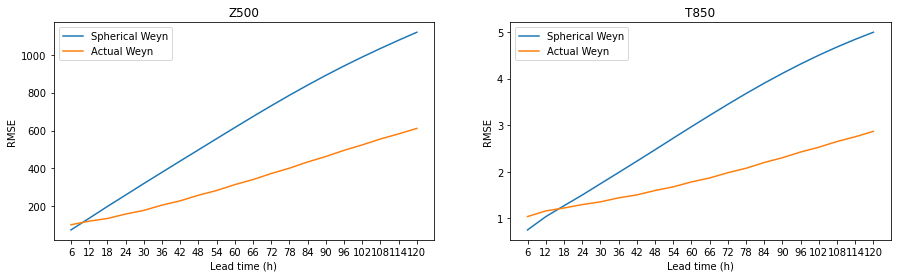

In [39]:
plot_rmses(rmse, rmses_weyn.rename({'z500':'z', 't850':'t'}).isel(lead_time=list(range(20))), lead_time=6)

#del spherical_unet
#del prediction_ds, rmse
torch.cuda.empty_cache()

In [40]:

from modules.plotting import plot_rmses
from modules.full_pipeline import load_data_split, WeatherBenchDatasetXarrayHealpixTemp, \
                                  train_model_2steps, create_iterative_predictions_healpix_temp, \
                                  compute_errors, plot_climatology, train_model_2steps_error
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple
from modules.data import hp_to_equiangular
import pandas as pd

In [41]:
lead_time = 6
delta_t = 6


In [42]:
pred_save_path  + description + '.nc'

'../data/healpix/predictions/masked_loss.nc'

In [43]:
start_time = len_sqce * lead_time - delta_t
end_time = (delta_t-lead_time) if (delta_t-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

pred = xr.open_mfdataset(pred_save_path  + "spherical_unet_" + description + '.nc', combine='by_coords',  chunks={'time':chunk_size})
obs = obs.isel(time=slice(delta_t,pred.time.shape[0]+delta_t))

In [45]:
metrics_path = datadir + "metrics/"

In [46]:
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(pred, obs)

rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

loading data
time to load data:  0.00012683868408203125
time mean obs  24.675318479537964
time mean pred  24.936638116836548
time std obs  49.62270998954773
time std pred  50.0091278553009
time cov  52.5499324798584
time corre_map  0.0037899017333984375
time rbias map  40.96049499511719
time rsd map  0.0024247169494628906
time rmse map  36.32730746269226


In [47]:
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + description + '.nc')

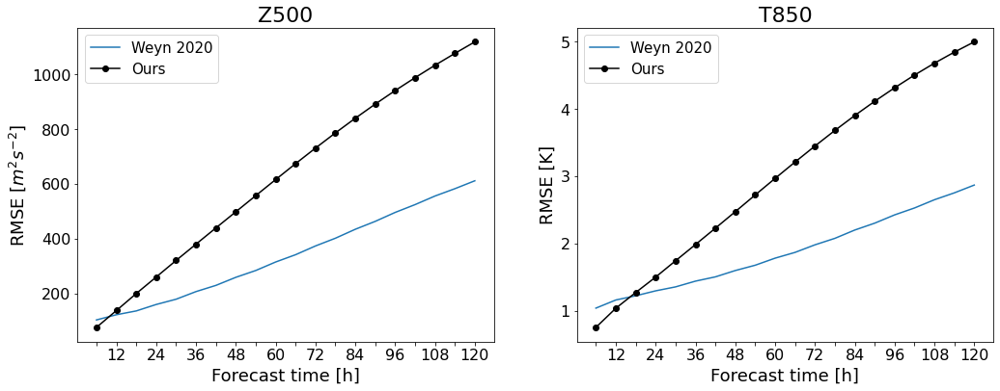

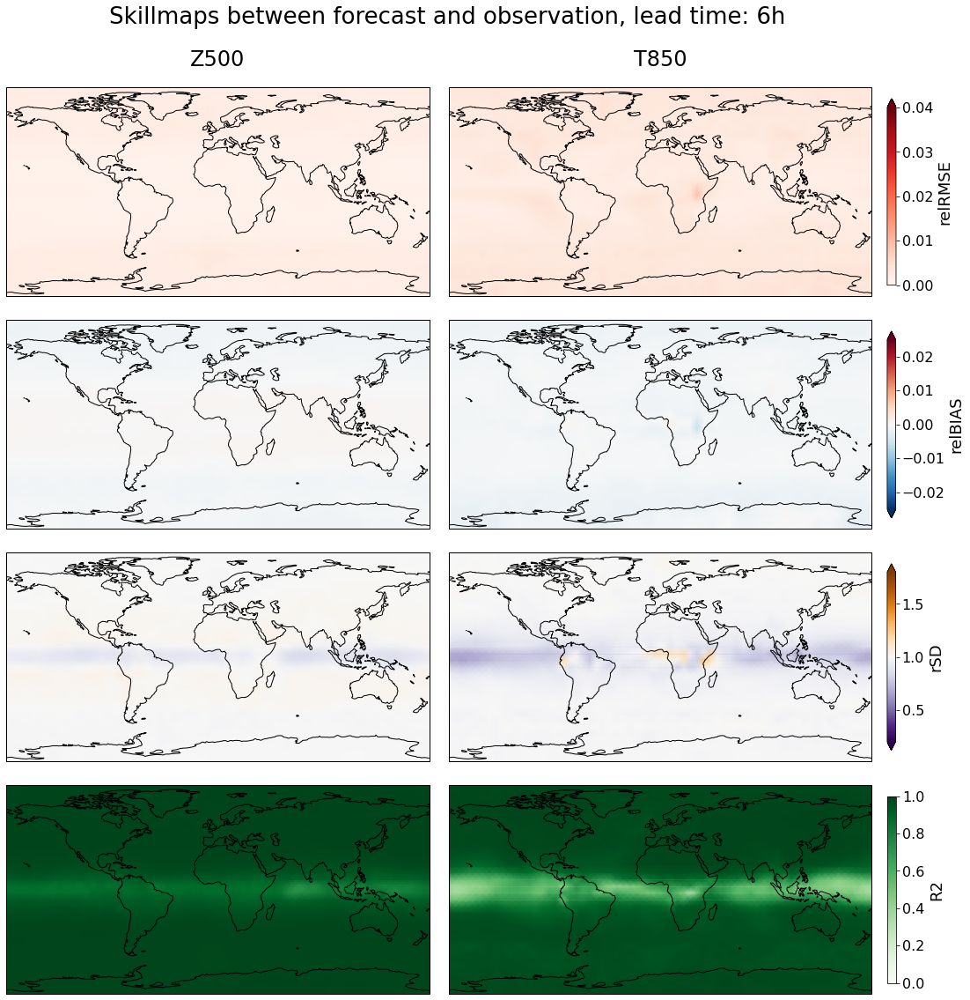

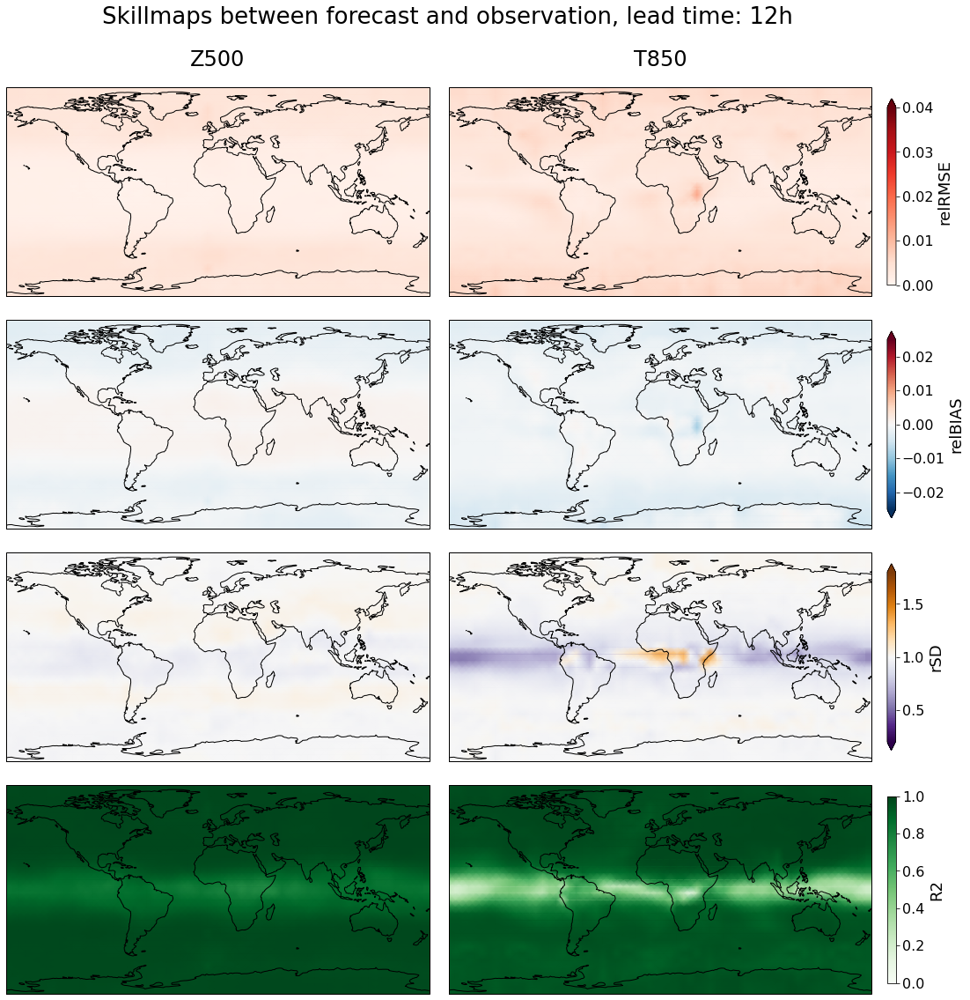

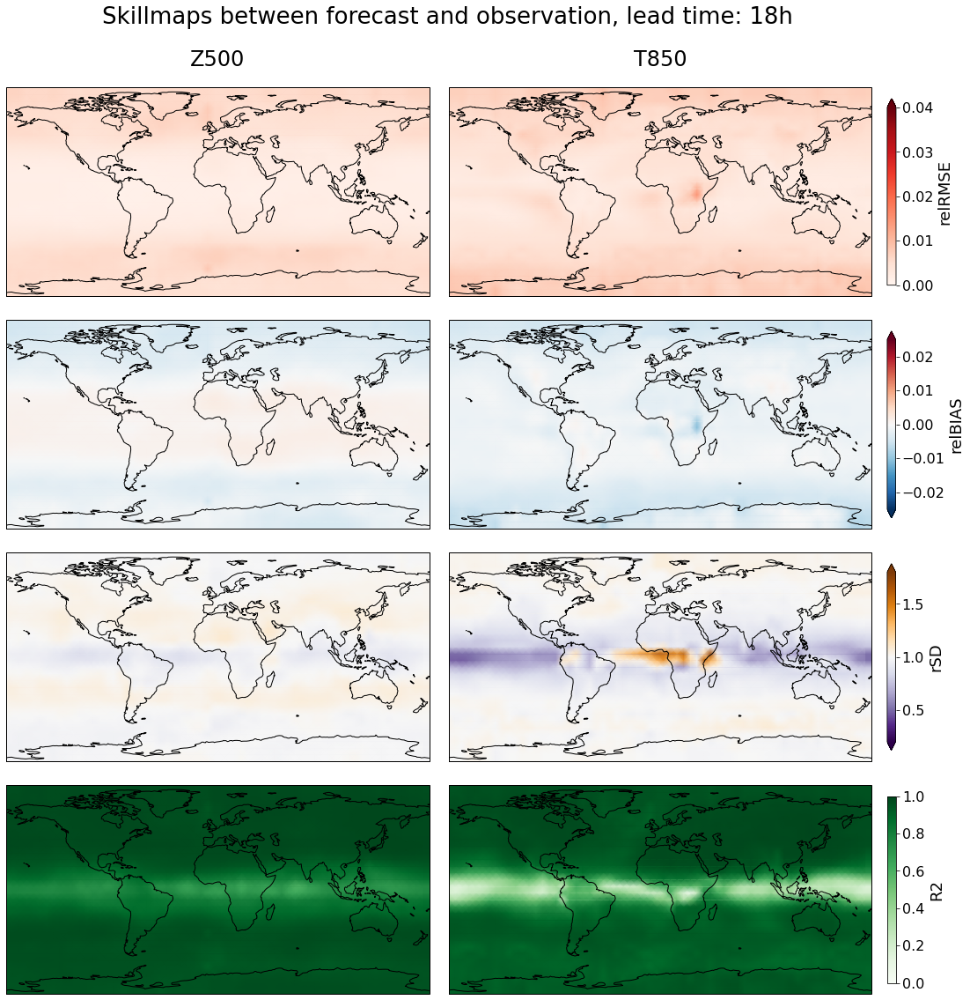

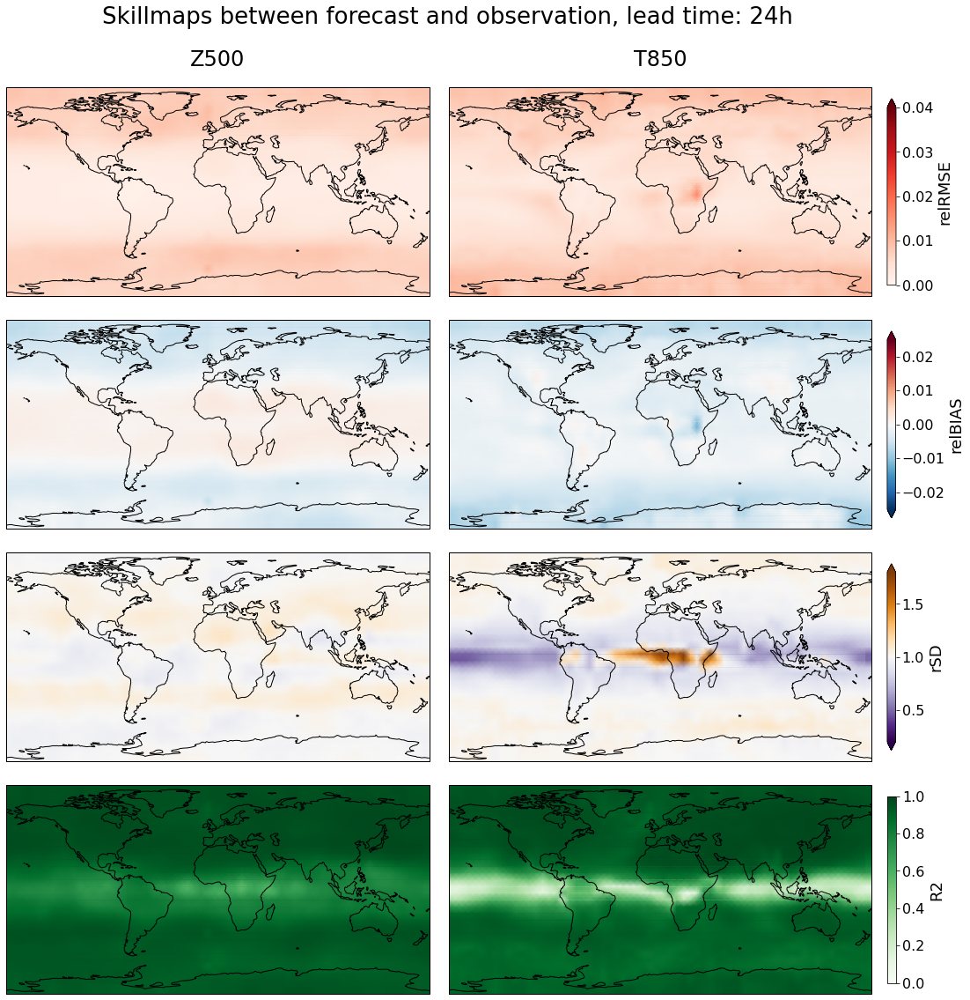

...

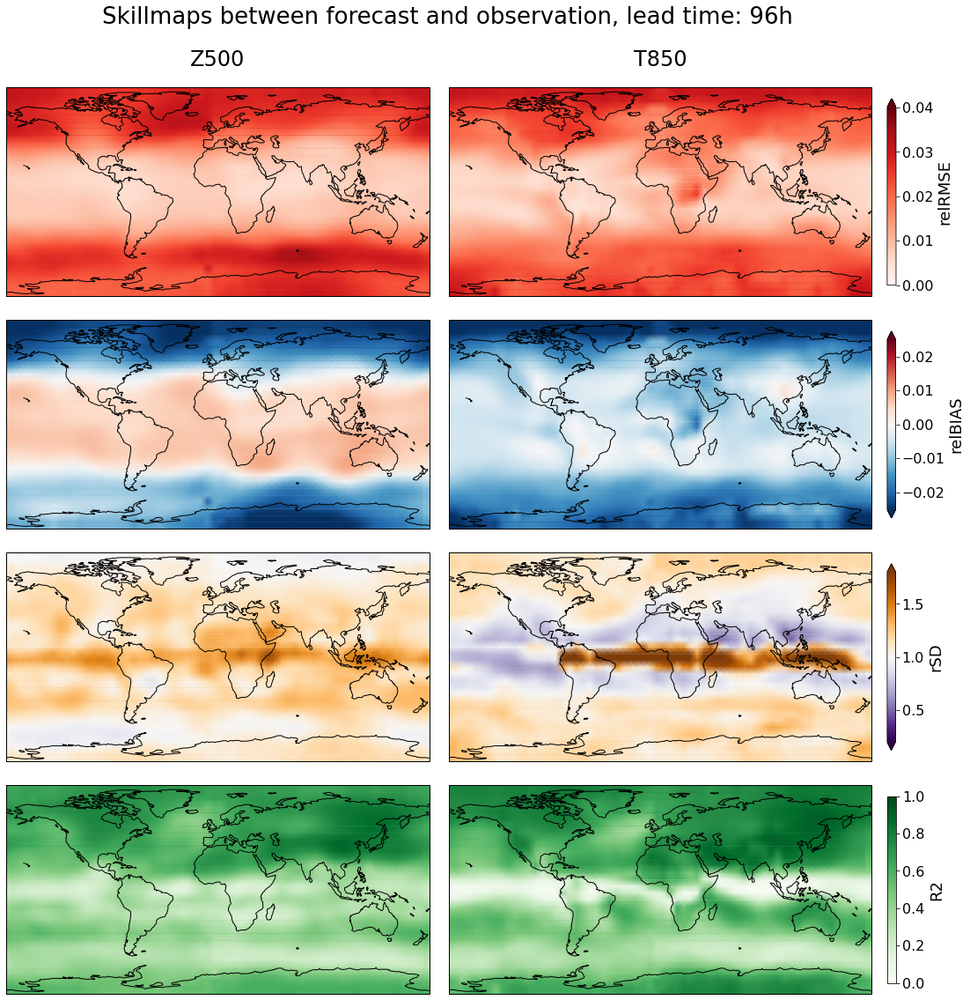

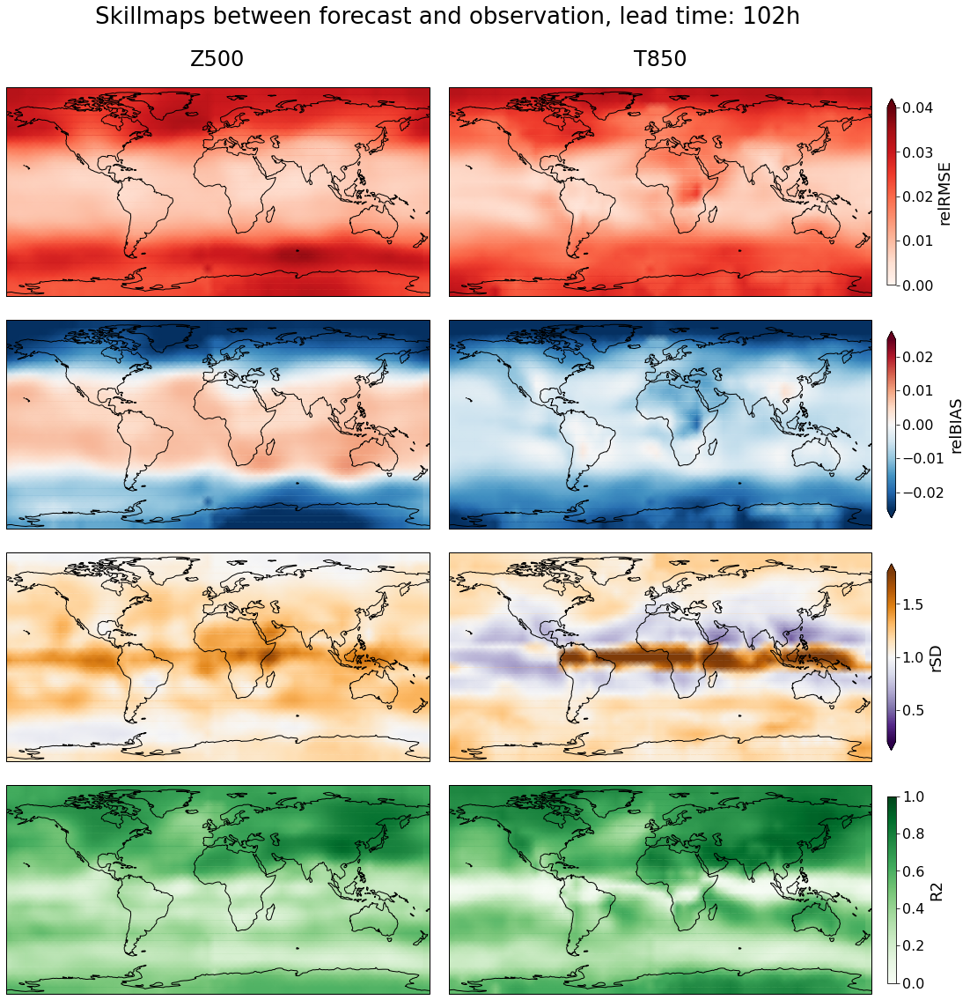

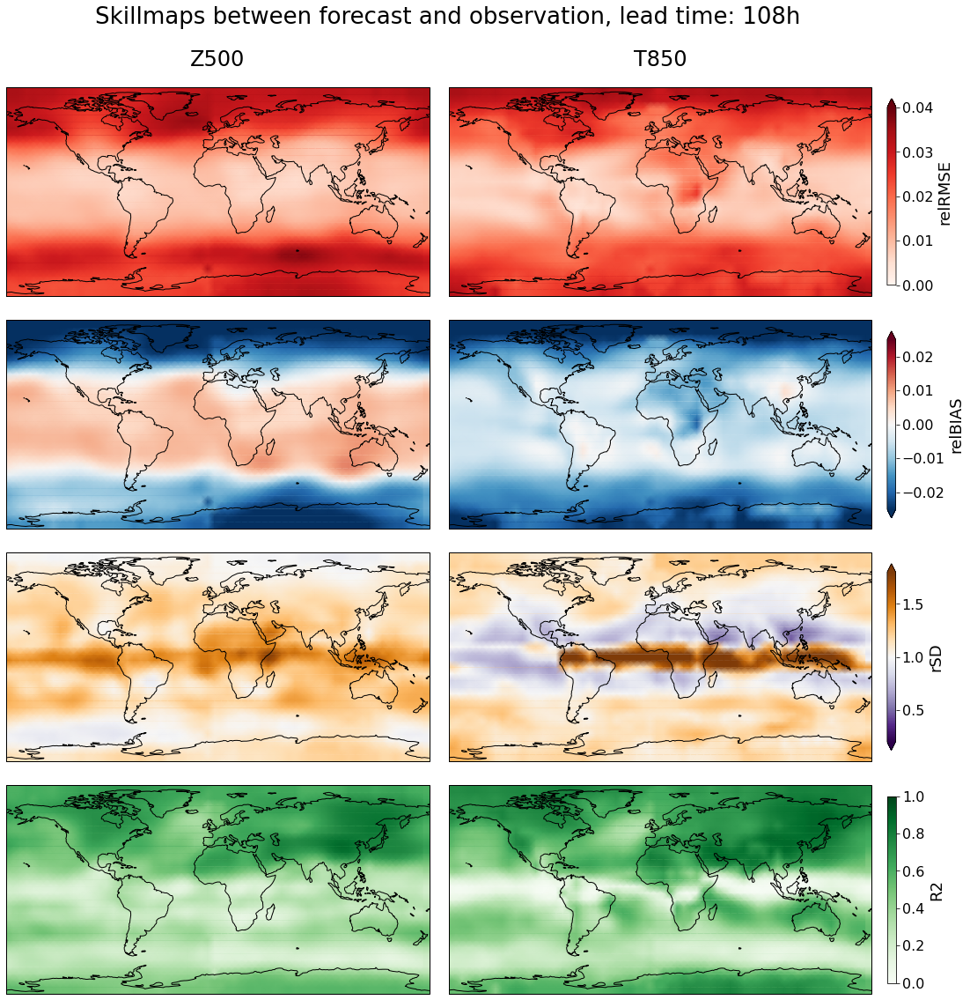

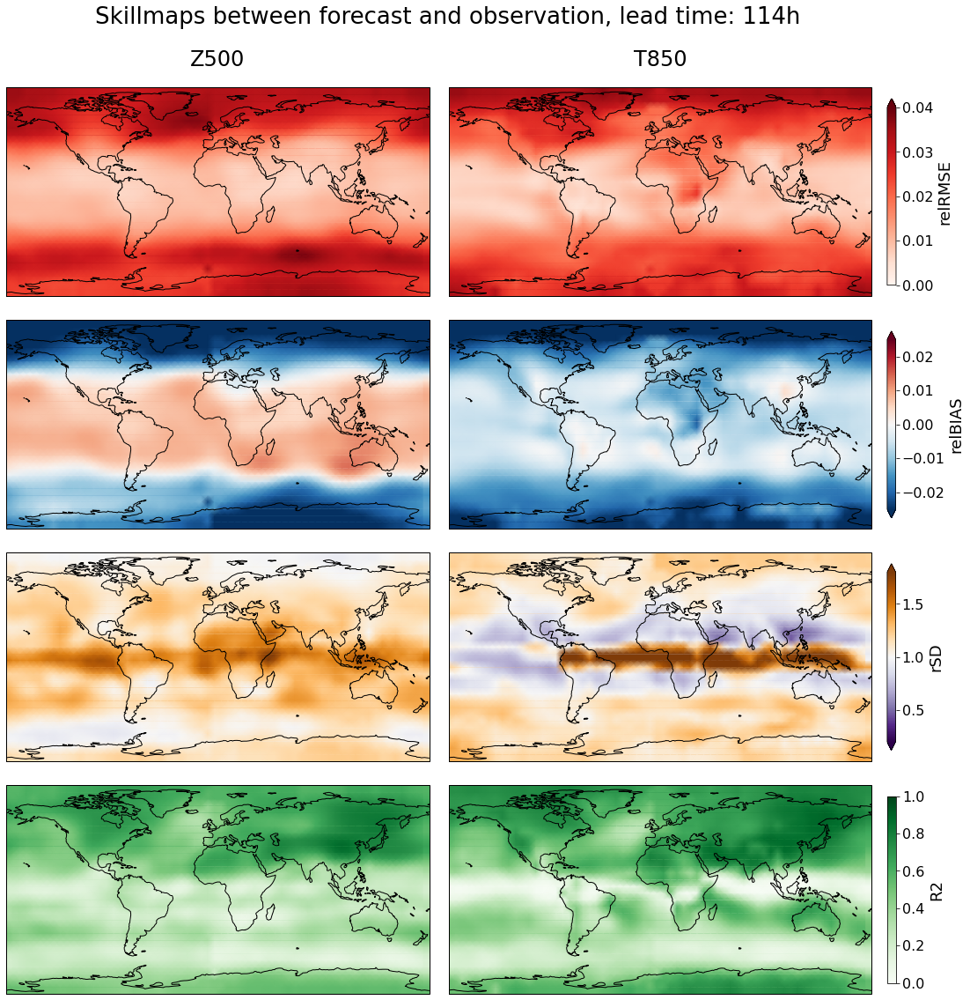

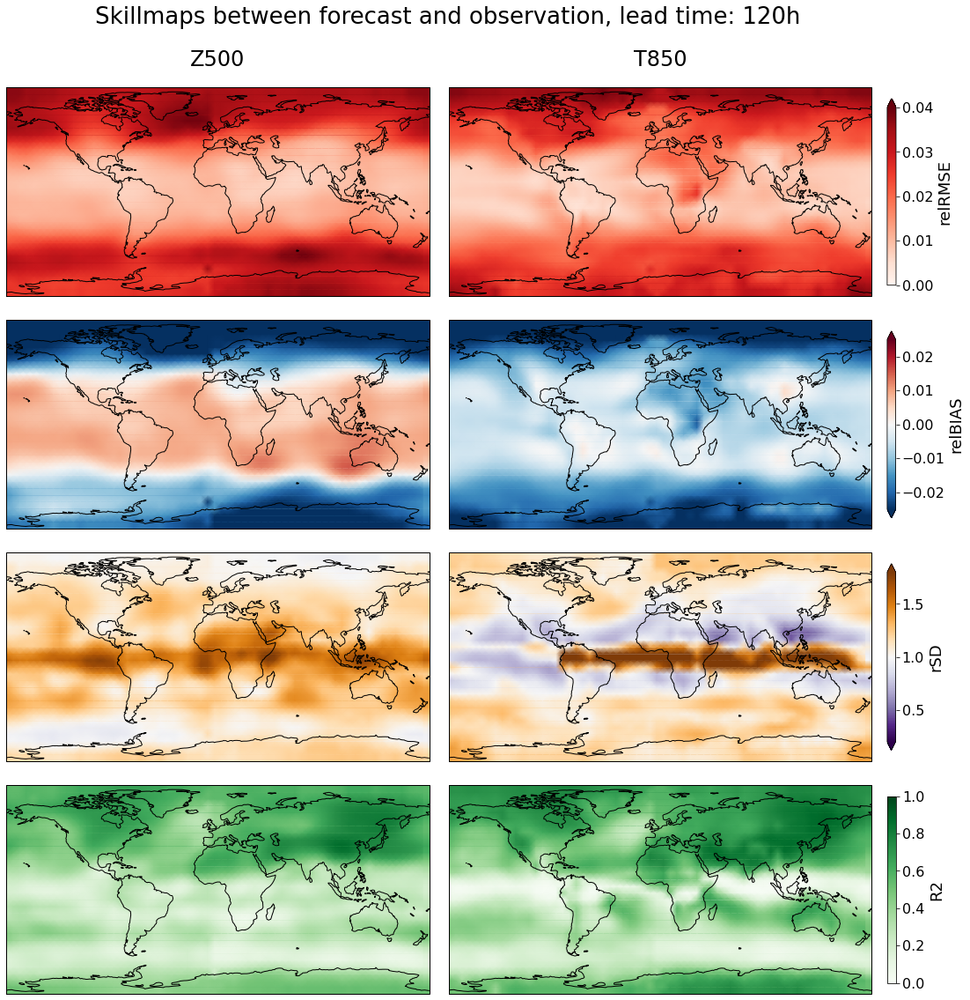

In [50]:
plot_benchmark_simple(rmse_spherical, description, lead_times,
                   input_dir=metrics_path, output_dir=figures_path, title=False)

resolution = 5.625

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description, lead_times, resolution,
               output_dir=figures_path)

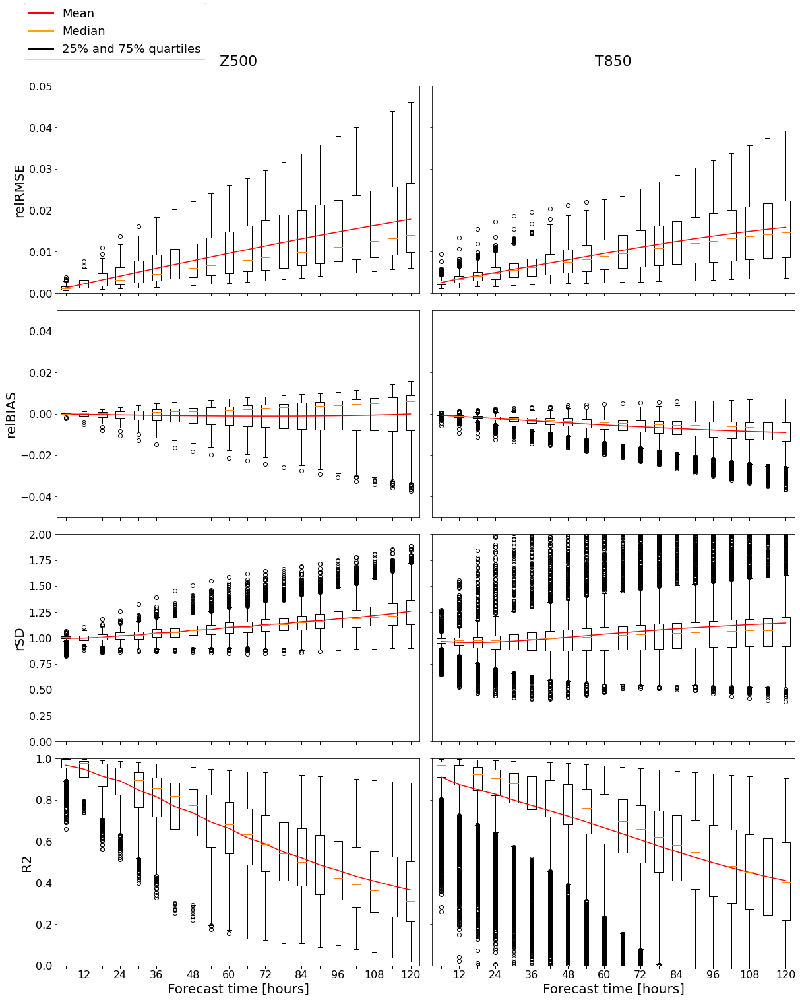

In [51]:
plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description, lead_times,
                    output_dir=figures_path, title=False)

In [52]:
monthly_mean = pred.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

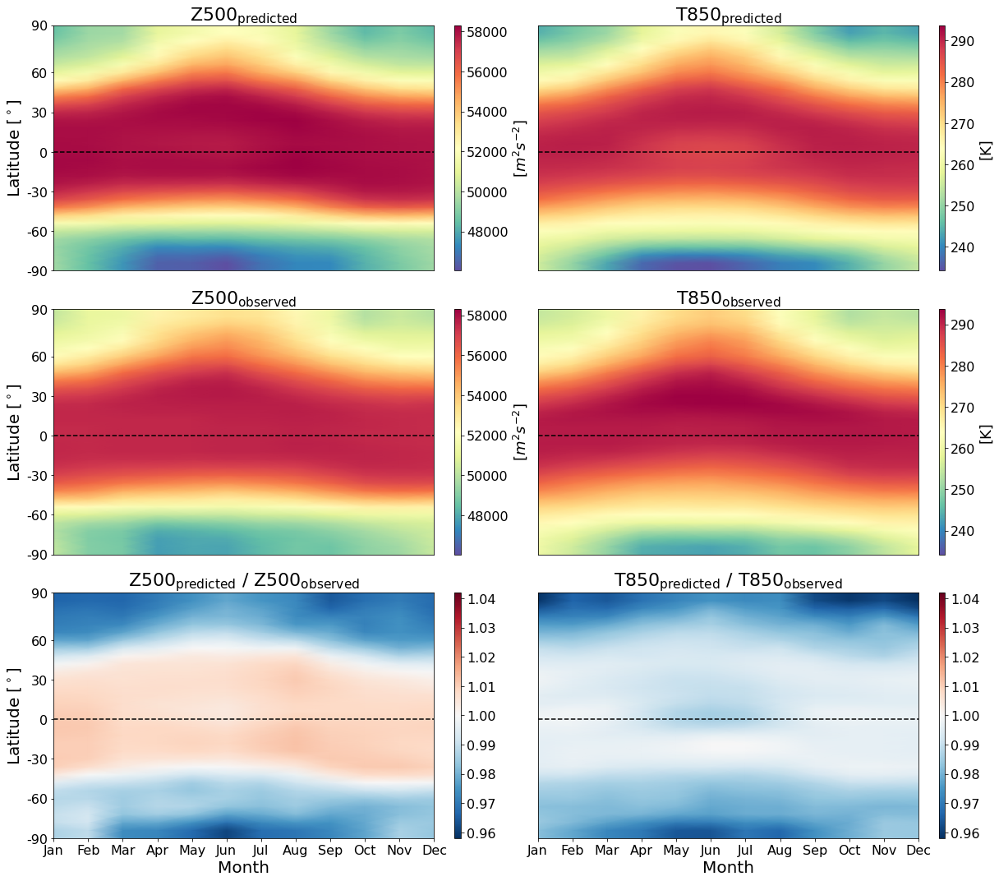

DONE!


In [53]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month),
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month),
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

predictions_vals = {'pred_z': pred_z, 'pred_t': pred_t,'obs_z': obs_z,'obs_t': obs_t}
val_limits = {'vmin_z':vmin_z, 'vmax_z':vmax_z, 'vmin_t':vmin_t, \
              'vmax_t':vmax_t, 'vmin_sd':vmin_sd, 'vmax_sd':vmax_sd}

figname = figures_path + description + '_hovmoller'
plot_climatology(figname, predictions_vals, val_limits, ticks, lat_labels, month_labels)

print('DONE!')